<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Import-packages" data-toc-modified-id="Import-packages-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Import packages</a></span></li><li><span><a href="#Set-Plot-Style-Defaults" data-toc-modified-id="Set-Plot-Style-Defaults-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Set Plot Style Defaults</a></span></li><li><span><a href="#Some-Functions" data-toc-modified-id="Some-Functions-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Some Functions</a></span></li><li><span><a href="#Some-Classes" data-toc-modified-id="Some-Classes-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Some Classes</a></span></li><li><span><a href="#Analysis" data-toc-modified-id="Analysis-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Analysis</a></span></li><li><span><a href="#Ages" data-toc-modified-id="Ages-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Ages</a></span></li><li><span><a href="#Simulation" data-toc-modified-id="Simulation-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Simulation</a></span><ul class="toc-item"><li><span><a href="#Starting-positions" data-toc-modified-id="Starting-positions-7.1"><span class="toc-item-num">7.1&nbsp;&nbsp;</span>Starting positions</a></span></li><li><span><a href="#Assign-ages-to-different-dots" data-toc-modified-id="Assign-ages-to-different-dots-7.2"><span class="toc-item-num">7.2&nbsp;&nbsp;</span>Assign ages to different dots</a></span></li><li><span><a href="#Perturb-locations" data-toc-modified-id="Perturb-locations-7.3"><span class="toc-item-num">7.3&nbsp;&nbsp;</span>Perturb locations</a></span></li><li><span><a href="#Get-distances" data-toc-modified-id="Get-distances-7.4"><span class="toc-item-num">7.4&nbsp;&nbsp;</span>Get distances</a></span></li><li><span><a href="#Run-initial-simulation" data-toc-modified-id="Run-initial-simulation-7.5"><span class="toc-item-num">7.5&nbsp;&nbsp;</span>Run initial simulation</a></span></li></ul></li><li><span><a href="#Write-code-as-separate-class-file" data-toc-modified-id="Write-code-as-separate-class-file-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Write code as separate class file</a></span><ul class="toc-item"><li><span><a href="#Stacked-area-chart-in-matplotlib" data-toc-modified-id="Stacked-area-chart-in-matplotlib-8.1"><span class="toc-item-num">8.1&nbsp;&nbsp;</span>Stacked area chart in matplotlib</a></span></li><li><span><a href="#Multiscenario" data-toc-modified-id="Multiscenario-8.2"><span class="toc-item-num">8.2&nbsp;&nbsp;</span>Multiscenario</a></span></li></ul></li><li><span><a href="#Plot-properties" data-toc-modified-id="Plot-properties-9"><span class="toc-item-num">9&nbsp;&nbsp;</span>Plot properties</a></span></li></ul></div>

# Import packages

In [54]:
import pandas as pd
import numpy as np
import numpy.matlib
import time
from scipy.stats import norm
import random
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import matplotlib.cm as cm
import networkx as nx
import calendar
import plotly_express as px
import tqdm

In [2]:
%load_ext autoreload
%autoreload 2

# Set Plot Style Defaults

In [3]:
rcParams['font.size'] = 16
rcParams['font.family'] = 'serif'
rcParams['legend.frameon'] = False
rcParams['text.color'] = 'grey'
rcParams['xtick.color'] = 'grey'
rcParams['ytick.color'] = 'grey'
rcParams['xtick.major.width'] = 2
rcParams['ytick.major.width'] = 2
rcParams['axes.labelcolor'] = 'grey'
rcParams['figure.figsize'] = (10,7)
rcParams['savefig.bbox'] = 'tight'
rcParams['savefig.dpi'] = 500
rcParams['savefig.transparent'] = True


rcParams['axes.spines.bottom'] = False
rcParams['axes.spines.left'] = False
rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['axes.grid'] = True
rcParams['axes.grid.axis'] = 'y'

plt.style.use(rcParams)

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'backend', that is not related to style.  Ignoring

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'backend.qt4', that is not related to style.  Ignoring

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'backend_fallback', that is not related to style.  Ignoring

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'datapath', that is not related to style.  Ignoring

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'docstring.hardcopy', that is not related to style.  Ignoring

/anaconda3/lib/python3.6/site-packages/matplotlib/style/core.py:100: UserWarning:

Style includes a parameter, 'figure.max_open_warning', that is not related to

# Some Functions

In [4]:
def a_func(*args, **kwargs):
    """ A function to do nothing """
    
    return None

def load_data(file):
    """ Simple function to load data straight from a table in redshift or a csv """
    
    if file[-4:] == '.csv':
        df = pd.read_csv(file)
    elif file.split('.')[0] == 'central_insights_sandbox':
        df = pd.read_sql_query(f"SELECT * FROM {file};", engine)
    elif file[-4:] == 'xlsx':
        df = pd.read_excel(file)
    return df

def run_query(sql_query):
    """ Pass in a sql query as a string, run it and pass the result back as a df """
    df = pd.read_sql_query(text(sql_query), engine)
    return df

def cross_join(df1, df2):
    """ Function to cross join two dataframes. Every row of df1 is joined to every other row in df2 """
    cols = list(df1) + list(df2)
    
    df1['key_462395'] = 1
    df2['key_462395'] = 1
    
    return pd.merge(df1,
             df2,
             how = 'inner',
             on = 'key_462395')[cols]

def plot_a_box(data, 
               box_loc, 
               ax,
               box_width = 0.5,
               whisker_width = 0.1,
               box_color = 'sandybrown',
               linewidth = 2,
               plot_outliers = True):
    
    q10 = np.quantile(data, 0.1)
    q25 = np.quantile(data, 0.25)
    q50 = np.quantile(data, 0.5)
    q75 = np.quantile(data, 0.75)
    q90 = np.quantile(data, 0.9)

    # Add whiskers
    ax.plot([box_loc - 0.5*whisker_width, box_loc + 0.5*whisker_width], 
             [q10, q10],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc - 0.5*whisker_width, box_loc + 0.5*whisker_width], 
             [q90, q90],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc, box_loc ], 
             [q10, q25],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc, box_loc ], 
             [q75, q90],
            color = box_color,
            linewidth = linewidth)

    # Add box
    ax.plot([box_loc - 0.5*box_width, box_loc + 0.5*box_width], 
             [q25, q25],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc - 0.5*box_width, box_loc + 0.5*box_width], 
             [q75, q75],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc - 0.5*box_width, box_loc - 0.5*box_width], 
             [q25, q75],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc + 0.5*box_width, box_loc + 0.5*box_width], 
             [q25, q75],
            color = box_color,
            linewidth = linewidth)
    ax.plot([box_loc - 0.5*box_width, box_loc + 0.5*box_width], 
             [q50, q50],
            color = box_color,
            linewidth = linewidth)

    ax.fill([box_loc - 0.5*box_width, box_loc + 0.5*box_width, box_loc + 0.5*box_width, box_loc - 0.5*box_width],
             [q25, q25, q75, q75],
             color = box_color,
             alpha = 0.5)
    
    if plot_outliers:
        outliers = data[(data < q10) | (data > q90)]
        ax.plot(box_loc * np.ones(len(outliers)), outliers, '.', color = 'silver')
    
    return ax

def import_BayesianOptimisation():
    import os
    working_dir = os.getcwd()
    os.chdir('/Users/crookm12/Documents/GitHub/BayesianOptimisation/')
    from bayesian_hyperparameter_optimisation_3 import BayesianOptimisation
    os.chdir(working_dir)

# Some Classes

In [43]:
class a_class(object):
    """ 
    A Class 
    
    --- Attributes ---
    an_attribute : None
    
    --- Methods ---
    a_method
        A function to do something
    """
    
    def __init__(self):
        self.an_attribute = None
        
    def a_method(self, *args, **kwargs):
        """ A function to do something """
        return None
        

# Analysis

In [225]:
df = pd.read_csv('COVID19_open_line_list.csv')
df.rename(columns = {'symptoms': 'symptom'},
          inplace = True)
dfs = df.loc[~df['symptom'].isnull()].copy()
dfs['symptom'] = dfs['symptom'].apply(lambda x: x.replace('feve\\', 'fever').replace('feaver', 'fever'))

FileNotFoundError: [Errno 2] File b'COVID19_open_line_list.csv' does not exist: b'COVID19_open_line_list.csv'

In [ ]:
symptom_set = set()
list_of_symptoms = list(set(dfs['symptom']))

for symp in list_of_symptoms:
    symptom_set = symptom_set.union(set(symp.split(', ')))
    


In [ ]:
symptom_list = list(symptom_set)
for symptom in symptom_list:
    dfs[symptom] = 0
    dfs.loc[dfs['symptom'].str.contains(symptom), symptom] = 1

In [ ]:
word = 'fever'
print(f"{len(dfs.loc[dfs['symptom'].str.contains(word)].index)} occurences of {word}")

In [ ]:
word = 'cough'
print(f"{len(dfs.loc[dfs['symptom'].str.contains(word)].index)} occurences of {word}")

In [ ]:
word = 'sputum'
print(f"{len(dfs.loc[dfs['symptom'].str.contains(word)].index)} occurences of {word}")

In [ ]:
symptom_list

# Ages

In [45]:
df = pd.read_csv('age_population.csv')

FileNotFoundError: [Errno 2] File b'age_population.csv' does not exist: b'age_population.csv'

In [ ]:
ages = df['i'].values
p_i = df['p_i'].values*1000000
H_i = df['H_i'].values
h_i = df['h_i'].values

In [ ]:
θ = 0.1
x_i = p_i * θ

In [ ]:
C = np.sum(x_i * h_i)
T = np.sum(x_i)

In [ ]:
T

In [ ]:
C = np.zeros(50)
T = np.zeros(50)
for j, θ in enumerate(np.linspace(0, 0.01)):
    x_i = p_i * θ
    C[j] = np.sum(x_i * h_i)
    T[j] = np.sum(x_i)

In [ ]:
plt.plot(C, T)

In [ ]:
6000 * T[-1] / C[-1]

In [ ]:
C

In [ ]:
θ = np.linspace(0, 0.01)[6]

In [ ]:
i[:14]

In [ ]:
x_i = p_i[:14] * θ
C = np.sum(x_i * h_i[:14])
T = np.sum(x_i)

In [ ]:
C

In [ ]:
T

# Simulation

## Starting positions

In [46]:
number_of_people = 100
x0 = np.random.uniform(0, 1, number_of_people)
y0 = np.random.uniform(0, 1, number_of_people)

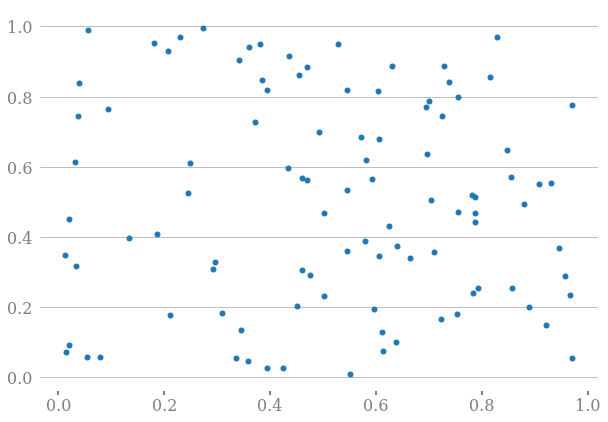

In [47]:
plt.plot(x0, y0, '.', markersize = 10)

## Assign ages to different dots

In [58]:
dfages = pd.read_csv('../data/age_population.csv')
ages_i = df['i'].values
p_i = df['p_i'].values*1000000
H_i = df['H_i'].values
h_i = df['h_i'].values

NameError: name 'df' is not defined

In [ ]:
ages = np.random.choice(a=ages_i, 
                        p=p_i / sum(p_i), 
                        size=number_of_people)

In [ ]:
number_of_cases = 6000000
# infection ratio across ages
θ = number_of_cases / sum(p_i)
infected = np.random.choice(a=[0, 1], p=[1 - θ, θ], size=number_of_people)
days_infected = infected.copy()

In [ ]:
# fraction of all asymptomatic cases - split across ages proportionally to the hospitalisation fraction
β = 0.5
symptomatic = np.random.choice(a=[0, 1], p=[β, 1-β], size=number_of_people) * infected

## Perturb locations

In [ ]:
loc = 0
scale = 0.01
def update_locations(x0, y0, loc, scale, number_of_people, deceased, is_shielding,
                     is_isolating):
    x1 = x0 + np.random.normal(loc=loc, scale=scale, size=number_of_people) \
        * (1 - deceased) * (1 - is_shielding) * (1 - is_isolating)
    y1 = y0 + np.random.normal(loc=loc, scale=scale, size=number_of_people) \
        * (1 - deceased) * (1 - is_shielding) * (1 - is_isolating)
#     x1 = x0 + np.random.uniform(-scale, scale, size = number_of_people)
#     y1 = y0 + np.random.uniform(-scale, scale, size = number_of_people)
    y1[y1 > 1] = 2 - y1[y1 > 1]
    y1[y1 < 0] = - y1[y1 < 0]
    x1[x1 > 1] = 2 - x1[x1 > 1]
    x1[x1 < 0] = - x1[x1 < 0]
    
    return x1, y1

In [ ]:
x1, y1 = update_locations(x0, y0, loc, scale, number_of_people)

In [ ]:
plt.plot(x0, y0, '.')
plt.plot(x1, y1, '.')

## Get distances

Create array where each row is a person and the columns show their distance from other people.

In [49]:
# count number of days infected
def update_days_infected(days_infected, infected):
    days_infected = days_infected + infected
    return days_infected

In [50]:
def spread_infections(x1, y1, infected, number_of_people, 
                      contamination_distance, immune, 
                      add_immunity, is_shielding):
    dist = np.zeros((number_of_people, number_of_people))
    for person in range(number_of_people):
        dist[person, :] = np.sqrt((x1 - x1[person])**2 + (y1 - y1[person])**2)
        
    # Who are close enough to pass infection
    close_together_people = 1 * (dist < contamination_distance)
    
    # cooccurence infection among each pair of people
    infected_delta = np.matlib.repmat(infected, number_of_people, 1)
    infected_delta = 1 * ((infected_delta + infected_delta.T) > 0)
    
    # Pass infection between infected people and people they are close enough to
    update_infected = 1 * ((close_together_people * infected_delta).sum(axis=1) > 0)
    if add_immunity:
        # remove people with immunity
        update_infected[immune == 1] = 0
        
    update_infected = update_infected * (1 - is_shielding)

    return update_infected

In [51]:
# remove cured people
def cure_people(days_infected, infected, days_until_cured, immune, deceased, d_i, ages_i, 
                is_isolating, isolate_sick, symptoms_start, is_symptomatic):
    infected[days_infected == days_until_cured] = 0
    immune[days_infected == days_until_cured] = 1
    for i, day in enumerate(days_infected):
        if days_infected[i] == days_until_cured:
            deceased[i] = np.random.choice(a=[0, 1], 
                                           p=[1 - d_i[ages[i]], d_i[ages[i]]])
            
    if isolate_sick:
        is_isolating[days_infected == symptoms_start] = 1
        is_isolating = is_isolating * is_symptomatic
        is_isolating[days_infected == days_until_cured] = 0
        
    
    days_infected[days_infected == days_until_cured] = 0
    return infected, days_infected, immune, deceased, is_isolating

In [52]:
def kill_people(infected, d_i, ages):
    deaths = [np.random.choice(a=[0, 1], p=[1 - d_i[age], d_i[age]]) for age in ages]
    return deaths

## Run initial simulation

In [53]:
dfages = pd.read_csv('age_population.csv')
ages_i = dfages['i'].values
p_i = dfages['p_i'].values*1000000
H_i = dfages['H_i'].values
h_i = dfages['h_i'].values
d_i = dict(zip(ages_i, 2 * h_i))

number_of_people = 200
contamination_distance = 0.030
θ = 3
hours_in_a_day = 12
days_until_cured = (5+7) * hours_in_a_day

x0 = np.random.uniform(0, 1, number_of_people)
y0 = np.random.uniform(0, 1, number_of_people)


# infection ratio across ages
if θ < 1:
    infected0 = np.random.choice(a=[0, 1], p=[1 - θ, θ], size=number_of_people)
else:
    infected0 = [1 for i in range(θ)] + [0 for i in range(number_of_people - θ)]
    np.random.shuffle(infected)
days_infected = infected0.copy()
immune0 = np.zeros(number_of_people)
deceased0 = np.zeros(number_of_people)

# fraction of all asymptomatic cases - split across ages proportionally to the hospitalisation fraction
γ = 10
symptom_rate = γ * h_i
symptom_rate[symptom_rate > 1] = 1
symptom_rate_dict = dict(zip(ages_i, symptom_rate))

ages = np.random.choice(a=ages_i, 
                        p=p_i / sum(p_i), 
                        size=number_of_people)

is_symptomatic = []
for person, age in enumerate(ages):
    βi = symptom_rate_dict[age]
    is_symptomatic.append(np.random.choice(a=[1, 0], p=[βi, 1-βi], size=number_of_people))

# for person in range(number_of_people):
#     β = h
# gets_symptoms = [np.random.choice(a=[0, 1], p=[β, 1-β], size=number_of_people)]

# plot color dict
infection_dict = {0: 'not_infected',
                  1: 'infected'}
person_colors = {0: 'steelblue',
                 1: 'firebrick'}
person_colors0 = {0: 'steelblue',
                 1: 'forestgreen'}
person_colors1 = {0: 'sandybrown',
                 1: 'firebrick'}


add_immunity = True
shield_over70s = False
close_schools = False
isolate_sick = True
include_asymptomatic = False
symptoms_start = 5 * hours_in_a_day

shield_ages = ['70-74', '75-79', '80-84', '85-90', '90+']
school_ages = ['0-4', '5-9', '10-14', '15-19']

is_shielding = np.zeros(number_of_people)
if shield_over70s:
    is_shielding = np.array([age in shield_ages for age in ages])
if close_schools:
    is_shielding = np.array([age in school_ages for age in ages])
if ~include_asymptomatic:
    is_symptomatic = np.ones(number_of_people)
    
is_isolating0 = np.zeros(number_of_people)
infected0 = infected0 * (1 - is_shielding)

FileNotFoundError: [Errno 2] File b'age_population.csv' does not exist: b'age_population.csv'

In [ ]:
dfplot = pd.DataFrame(columns = ['x', 'y', 'color', 'day', 'infected', 'person_id', 'immune', 'deceased'])
dfplot['x'] = x0
dfplot['y'] = y0
dfplot['color'] = [person_colors[inf_] for inf_ in infected0]
dfplot['day'] = 0
dfplot['size'] = 2
dfplot['person_id'] = range(number_of_people)
dfplot['infected'] = infected0
dfplot['infection_status'] = [infection_dict[inf_] for inf_ in infected0]
dfplot['immune'] = 0
dfplot['deceased'] = 0

In [ ]:
for i in range(1, 2*14*24):
    number_of_infections = dfplot.loc[(dfplot['day'] == dfplot['day'].max())
           & (dfplot['infected'] == 1), 'infected'].count()
    if number_of_infections > 0:
        x1, y1 = update_locations(x0, y0, loc, scale, number_of_people, 
                                  deceased0, is_shielding,
                                  is_isolating0)
        infected1 = spread_infections(x1, y1, infected0, number_of_people, 
                                      contamination_distance, immune0, add_immunity, is_shielding)
        days_infected = update_days_infected(days_infected, infected1)
        infected1, days_infected, immune1, deceased1, is_isolating1 = cure_people(
            days_infected, infected1, days_until_cured, immune0, deceased0,
            d_i, ages, is_isolating0, isolate_sick, symptoms_start, is_symptomatic)

        df_ = pd.DataFrame(columns = ['x', 'y', 'color', 'day', 'size', 'infected', 'person_id', 'immune'])
        df_['x'] = x1
        df_['y'] = y1
        df_['color'] = [person_colors[inf_] for inf_ in infected1]
        df_['day'] = i
        df_['size'] = 2
        df_['person_id'] = range(number_of_people)
        df_['infected'] = infected1
        df_['infection_status'] = [infection_dict[inf_] for inf_ in infected1]
        df_['immune'] = immune1
        df_['deceased'] = deceased1
        df_.loc[df_['immune'] == 1, 'infected'] = 2
        df_.loc[df_['deceased'] == 1, 'infected'] = 3
        dfplot = pd.concat((dfplot, df_), sort=False)

        infected0 = infected1
        x0 = x1
        y0 = y1
        immune0 = immune1
        deceased0 = deceased1
        is_isolating0 = is_isolating1

In [ ]:
# import plotly.express as px
df = px.data.gapminder()
px.scatter(dfplot, x="x", y="y", animation_frame="day", size='size', animation_group="person_id",
           color="infected", hover_name='person_id',
           size_max=5, range_x=[0, 1], range_y=[0, 1], range_color = [0, 3],
           color_continuous_scale=['steelblue', 'sandybrown', 'forestgreen', 'firebrick'])

In [ ]:
dfarea = dfplot.groupby(['day', 'infected'], as_index=False)['person_id'].count()
dfarea['person_id'] *= (100 / number_of_people) 

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
groups = [[1], [2], [0], [3]]
names = ['infected', 'immune', 'not infected', 'deceased']
colors = ['steelblue', 'sandybrown', 'forestgreen', 'firebrick']
for gid, group in enumerate(groups):
    dfg = dfarea.loc[dfarea['infected'].isin(group)].groupby('day')['person_id'].sum()
    fig.add_trace(go.Scatter(
        x=dfg.index, 
        y=dfg.values,
        mode='lines',
        line=dict(width=0.5, color=colors[group[-1]]),
        stackgroup='one',
        groupnorm='percent',
        hoverinfo='text',
        hovertext=None,
        name = names[gid]
    ))
    
fig.update_layout(
    showlegend=True)
fig.update_layout(
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))


fig.show()

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
groups = [[1], [2], [0], [3]]
names = ['infected', 'immune', 'not infected', 'deceased']
colors = ['steelblue', 'sandybrown', 'forestgreen', 'firebrick']
for gid, group in enumerate(groups):
    dfg = dfarea.loc[dfarea['infected'].isin(group)].groupby('day')['person_id'].sum()
    fig.add_trace(go.Scatter(
        x=dfg.index, 
        y=dfg.values,
        mode='lines',
        line=dict(width=0.5, color=colors[group[-1]]),
        stackgroup='one',
        groupnorm='percent',
        hoverinfo='text',
        hovertext=None,
        name = names[gid]
    ))
    
fig.update_layout(
    showlegend=True)
fig.update_layout(
    yaxis=dict(
        type='linear',
        range=[1, 100],
        ticksuffix='%'))


fig.show()

# Write code as separate class file

In [7]:
import os
cwd = os.getcwd()
os.chdir('../src')
from model_code import disease_model_class
os.chdir(cwd)

import time

In [59]:
disease_model = disease_model_class(add_immunity=False,
                                    social_distance=False,
                                    shield_over70s=False)
disease_model.run_simulation(timesteps = 504)

In [64]:
disease_model.visualise_simulation(save_as_html=True)

Saving viz for scenario FFFFFF...


In [42]:
fig = disease_model.plot_results()

Saving results for scenario FFFFFF...


In [43]:
# disease_model.dfplot.to_csv('../data/test_data_dump.csv', index=False)

In [44]:
# tic = time.time()
# disease_model.dfplot = pd.read_csv('../data/test_data_dump.csv')
# disease_model.visualise_simulation()
# print(f"toc {time.time() - tic}")

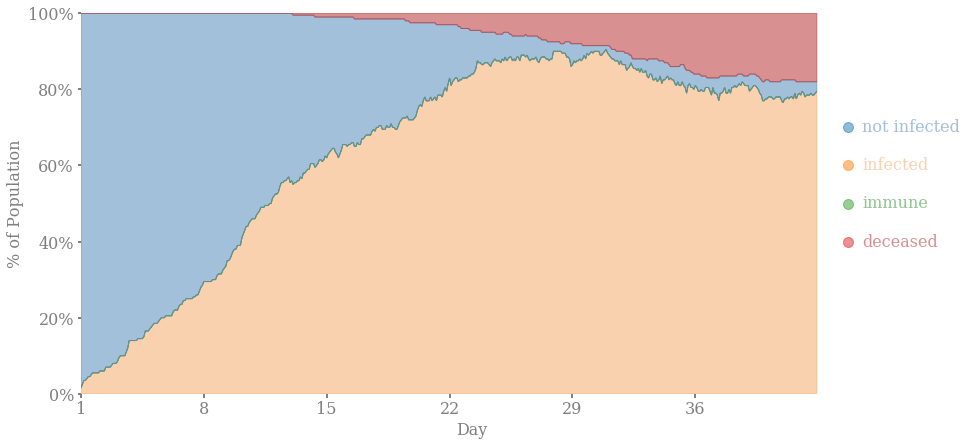

In [45]:
disease_model.matplotlib_area_plot()

## Stacked area chart in matplotlib

In [63]:
disease_model.timesteps=500

[autoreload of model_code failed: Traceback (most recent call last):
  File "/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 244, in check
    superreload(m, reload, self.old_objects)
  File "/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 378, in superreload
    module = reload(module)
  File "/anaconda3/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/anaconda3/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 600, in _exec
AttributeError: 'NoneType' object has no attribute 'name'
]


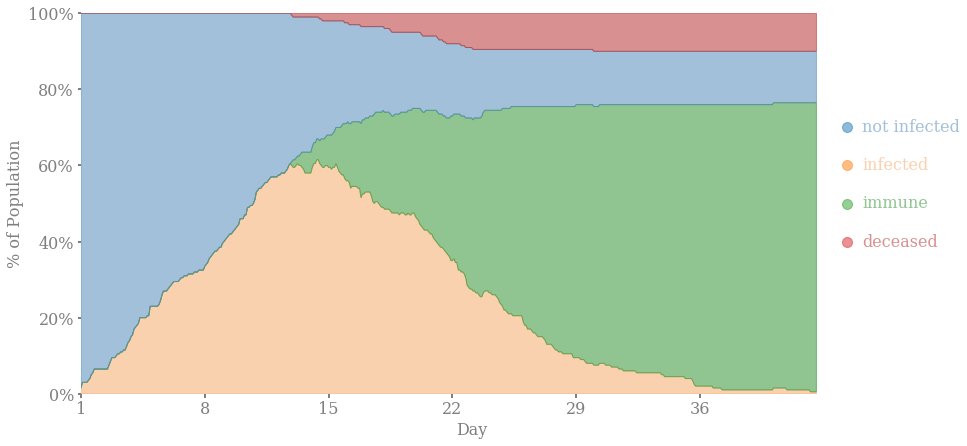

In [166]:
dfarea = (disease_model.dfplot
 .groupby(['day_ind', 'day', 'infected'], as_index=False)['person_id']
 .count()
 .sort_values('day_ind', ascending=True))

f, ax = plt.subplots(1, 1, figsize=(14, 7))

groups = [1, 2, 0, 3]
names = ['not infected', 'infected', 'immune', 'deceased']
colors = ['steelblue', 'sandybrown', 'forestgreen', 'firebrick']
        
x = list(dfarea['day_ind'].drop_duplicates())
x = x + [x[-(1 + i)] for i in x]

dfarea = pd.merge(
    (dfarea.pivot(columns = 'infected',
                  index='day_ind',
                  values='person_id')
     .fillna(0)
     .reset_index()),
    dfarea[['day_ind', 'day']].drop_duplicates(),
    how = 'left',
    on = 'day_ind')
dfarea.loc[:, range(4)] = 100 * dfarea[range(4)] / disease_model.number_of_people

for group_id in range(4):
    group = groups[group_id]
    if group_id == 0:
        y0 = np.zeros(disease_model.timesteps)
    else:
        y0 = dfarea[groups[:group_id]].sum(axis=1).values
    y1 = np.fliplr(dfarea[groups[:(1 + group_id)]].sum(axis=1).values.reshape(1, -1))[0]
    y = np.concatenate([y0, y1])
    ax.fill(x, y,
            color = colors[group],
            alpha = 0.5)

ax.set_ylim(0, 100)
ax.axes.grid(False)
ax.set_xlim(0, disease_model.timesteps + 30)
ax.set_yticks(range(0, 101, 20))
ax.set_yticklabels([f"{i}%" for i in range(0, 101, 20)])

xticks = dfarea.loc[range(0, disease_model.timesteps, 7*disease_model.hours_in_a_day), 'day_ind']
ax.set_xticks(xticks)
ax.set_xticklabels([1 + int(i/disease_model.hours_in_a_day) for i in xticks])
ax.set_xlabel('Day')
ax.set_ylabel('% of Population')

dot_offset = 20
text_offset = 10
ylocs = range(70, 30, -10)
for i, yi in enumerate(ylocs):
    color = colors[i]
    ax.plot(disease_model.timesteps + dot_offset,
            yi,
            '.',
            markersize=20,
            alpha=0.5)
    ax.text(x = disease_model.timesteps + dot_offset + text_offset,
            y = yi,
            s = names[i],
            verticalalignment='center',
            horizontalalignment='left',
            alpha=0.5,
            color=color)

plt.show()

f.savefig('../figures/test_stacked_bar_chart.png')

0        0
84      84
168    168
252    252
336    336
420    420
Name: day_ind, dtype: int64

## Multiscenario

  0%|          | 0/64 [00:00<?, ?it/s]

Saving viz for scenario TTTTTT...
Saving matplotlib fig for scenario TTTTTT...


  2%|▏         | 1/64 [00:22<23:24, 22.29s/it]

Saving viz for scenario FTTTTT...
Saving matplotlib fig for scenario FTTTTT...


  3%|▎         | 2/64 [00:44<23:08, 22.40s/it]

Saving viz for scenario TFTTTT...
Saving matplotlib fig for scenario TFTTTT...


  5%|▍         | 3/64 [01:03<21:30, 21.15s/it]

Saving viz for scenario FFTTTT...
Saving matplotlib fig for scenario FFTTTT...


  6%|▋         | 4/64 [01:29<22:37, 22.63s/it]

Saving viz for scenario TTFTTT...
Saving matplotlib fig for scenario TTFTTT...


  8%|▊         | 5/64 [01:54<23:09, 23.55s/it]

Saving viz for scenario FTFTTT...
Saving matplotlib fig for scenario FTFTTT...


  9%|▉         | 6/64 [02:15<21:50, 22.60s/it]

Saving viz for scenario TFFTTT...
Saving matplotlib fig for scenario TFFTTT...


 11%|█         | 7/64 [02:33<20:14, 21.31s/it]

Saving viz for scenario FFFTTT...
Saving matplotlib fig for scenario FFFTTT...


 12%|█▎        | 8/64 [02:51<18:56, 20.30s/it]

Saving viz for scenario TTTFTT...
Saving matplotlib fig for scenario TTTFTT...


 14%|█▍        | 9/64 [03:11<18:30, 20.20s/it]

Saving viz for scenario FTTFTT...
Saving matplotlib fig for scenario FTTFTT...


 16%|█▌        | 10/64 [03:28<17:19, 19.26s/it]

Saving viz for scenario TFTFTT...
Saving matplotlib fig for scenario TFTFTT...


 17%|█▋        | 11/64 [03:46<16:31, 18.70s/it]

Saving viz for scenario FFTFTT...
Saving matplotlib fig for scenario FFTFTT...


 19%|█▉        | 12/64 [04:06<16:46, 19.36s/it]

Saving viz for scenario TTFFTT...
Saving matplotlib fig for scenario TTFFTT...


 20%|██        | 13/64 [04:29<17:18, 20.36s/it]

Saving viz for scenario FTFFTT...
Saving matplotlib fig for scenario FTFFTT...


 22%|██▏       | 14/64 [04:49<16:46, 20.14s/it]

Saving viz for scenario TFFFTT...
Saving matplotlib fig for scenario TFFFTT...


 23%|██▎       | 15/64 [05:08<16:12, 19.85s/it]

Saving viz for scenario FFFFTT...
Saving matplotlib fig for scenario FFFFTT...


 25%|██▌       | 16/64 [05:27<15:41, 19.61s/it]

Saving viz for scenario TTTTFT...
Saving matplotlib fig for scenario TTTTFT...


 27%|██▋       | 17/64 [05:48<15:47, 20.16s/it]

Saving viz for scenario FTTTFT...
Saving matplotlib fig for scenario FTTTFT...


 28%|██▊       | 18/64 [06:10<15:50, 20.66s/it]

Saving viz for scenario TFTTFT...
Saving matplotlib fig for scenario TFTTFT...


 30%|██▉       | 19/64 [06:36<16:42, 22.27s/it]

Saving viz for scenario FFTTFT...
Saving matplotlib fig for scenario FFTTFT...


 31%|███▏      | 20/64 [06:55<15:39, 21.34s/it]

Saving viz for scenario TTFTFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFTFT...


 33%|███▎      | 21/64 [07:20<16:02, 22.38s/it]

Saving viz for scenario FTFTFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFTFT...


 34%|███▍      | 22/64 [07:39<15:00, 21.43s/it]

Saving viz for scenario TFFTFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFTFT...


 36%|███▌      | 23/64 [08:02<14:50, 21.73s/it]

Saving viz for scenario FFFTFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFTFT...


 38%|███▊      | 24/64 [08:19<13:35, 20.39s/it]

Saving viz for scenario TTTFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTTFFT...


 39%|███▉      | 25/64 [08:48<14:55, 22.96s/it]

Saving viz for scenario FTTFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTTFFT...


 41%|████      | 26/64 [09:11<14:32, 22.96s/it]

Saving viz for scenario TFTFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFTFFT...


 42%|████▏     | 27/64 [09:35<14:16, 23.14s/it]

Saving viz for scenario FFTFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFTFFT...


 44%|████▍     | 28/64 [09:55<13:26, 22.41s/it]

Saving viz for scenario TTFFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFFFT...


 45%|████▌     | 29/64 [10:21<13:43, 23.52s/it]

Saving viz for scenario FTFFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFFFT...


 47%|████▋     | 30/64 [10:45<13:18, 23.49s/it]

Saving viz for scenario TFFFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFFFT...


 48%|████▊     | 31/64 [11:09<13:06, 23.83s/it]

Saving viz for scenario FFFFFT...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFFFT...


 50%|█████     | 32/64 [11:35<12:54, 24.19s/it]

Saving viz for scenario TTTTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTTTTF...


 52%|█████▏    | 33/64 [11:57<12:11, 23.59s/it]

Saving viz for scenario FTTTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTTTTF...


 53%|█████▎    | 34/64 [12:24<12:18, 24.63s/it]

Saving viz for scenario TFTTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFTTTF...


 55%|█████▍    | 35/64 [12:45<11:24, 23.59s/it]

Saving viz for scenario FFTTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFTTTF...


 56%|█████▋    | 36/64 [13:06<10:36, 22.72s/it]

Saving viz for scenario TTFTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFTTF...


 58%|█████▊    | 37/64 [13:33<10:50, 24.11s/it]

Saving viz for scenario FTFTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFTTF...


 59%|█████▉    | 38/64 [13:58<10:34, 24.39s/it]

Saving viz for scenario TFFTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFTTF...


 61%|██████    | 39/64 [14:20<09:53, 23.76s/it]

Saving viz for scenario FFFTTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFTTF...


 62%|██████▎   | 40/64 [14:43<09:24, 23.53s/it]

Saving viz for scenario TTTFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTTFTF...


 64%|██████▍   | 41/64 [15:01<08:19, 21.71s/it]

Saving viz for scenario FTTFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTTFTF...


 66%|██████▌   | 42/64 [15:20<07:42, 21.01s/it]

Saving viz for scenario TFTFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFTFTF...


 67%|██████▋   | 43/64 [15:37<06:56, 19.83s/it]

Saving viz for scenario FFTFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFTFTF...


 69%|██████▉   | 44/64 [15:56<06:27, 19.40s/it]

Saving viz for scenario TTFFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFFTF...


 70%|███████   | 45/64 [16:17<06:22, 20.11s/it]

Saving viz for scenario FTFFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFFTF...


 72%|███████▏  | 46/64 [16:37<06:01, 20.08s/it]

Saving viz for scenario TFFFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFFTF...


 73%|███████▎  | 47/64 [16:55<05:28, 19.33s/it]

Saving viz for scenario FFFFTF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFFTF...


 75%|███████▌  | 48/64 [17:14<05:07, 19.21s/it]

Saving viz for scenario TTTTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTTTFF...


 77%|███████▋  | 49/64 [17:35<04:54, 19.64s/it]

Saving viz for scenario FTTTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTTTFF...


 78%|███████▊  | 50/64 [17:57<04:47, 20.55s/it]

Saving viz for scenario TFTTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFTTFF...


 80%|███████▉  | 51/64 [18:21<04:40, 21.59s/it]

Saving viz for scenario FFTTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFTTFF...


 81%|████████▏ | 52/64 [18:50<04:43, 23.62s/it]

Saving viz for scenario TTFTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFTFF...


 83%|████████▎ | 53/64 [19:07<03:59, 21.81s/it]

Saving viz for scenario FTFTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFTFF...


 84%|████████▍ | 54/64 [19:28<03:35, 21.58s/it]

Saving viz for scenario TFFTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFTFF...


 86%|████████▌ | 55/64 [19:53<03:23, 22.58s/it]

Saving viz for scenario FFFTFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFTFF...


 88%|████████▊ | 56/64 [20:16<03:00, 22.58s/it]

Saving viz for scenario TTTFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTTFFF...


 89%|████████▉ | 57/64 [20:35<02:31, 21.63s/it]

Saving viz for scenario FTTFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTTFFF...


 91%|█████████ | 58/64 [20:52<02:02, 20.34s/it]

Saving viz for scenario TFTFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFTFFF...


 92%|█████████▏| 59/64 [21:12<01:40, 20.05s/it]

Saving viz for scenario FFTFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFTFFF...


 94%|█████████▍| 60/64 [21:30<01:17, 19.49s/it]

Saving viz for scenario TTFFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TTFFFF...


 95%|█████████▌| 61/64 [21:54<01:02, 20.70s/it]

Saving viz for scenario FTFFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FTFFFF...


 97%|█████████▋| 62/64 [22:17<00:42, 21.47s/it]

Saving viz for scenario TFFFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario TFFFFF...


 98%|█████████▊| 63/64 [22:40<00:21, 21.86s/it]

Saving viz for scenario FFFFFF...


/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Saving matplotlib fig for scenario FFFFFF...


100%|██████████| 64/64 [23:05<00:00, 21.65s/it]


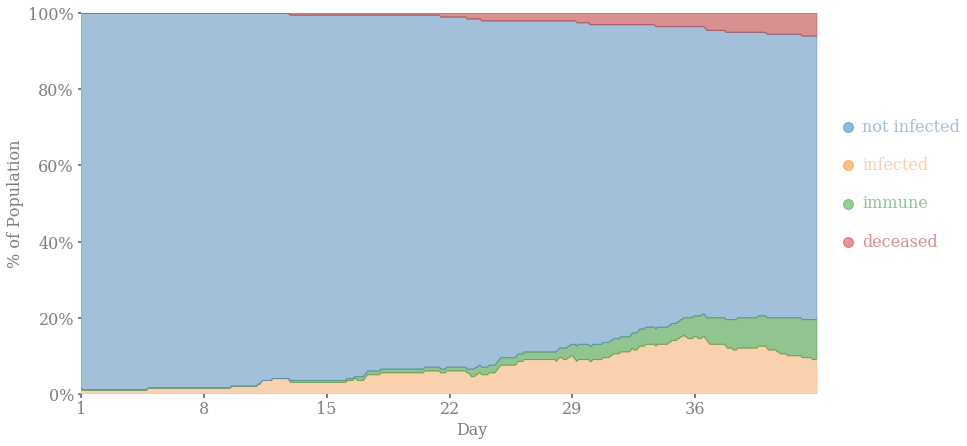

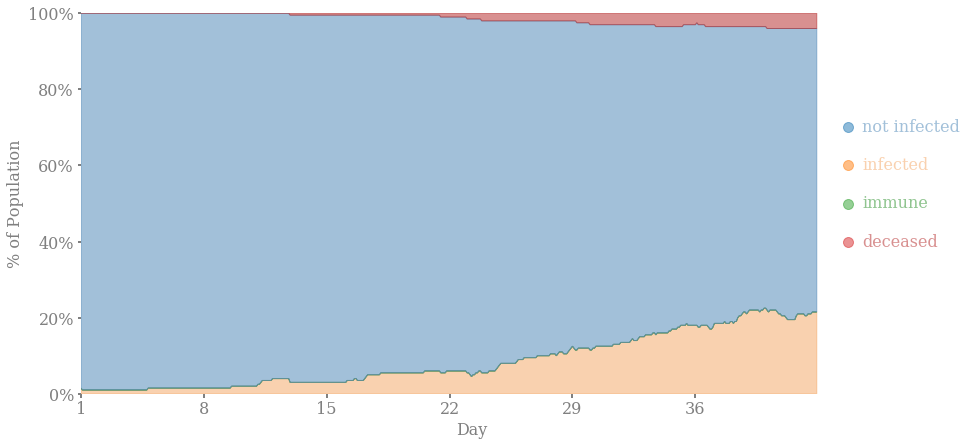

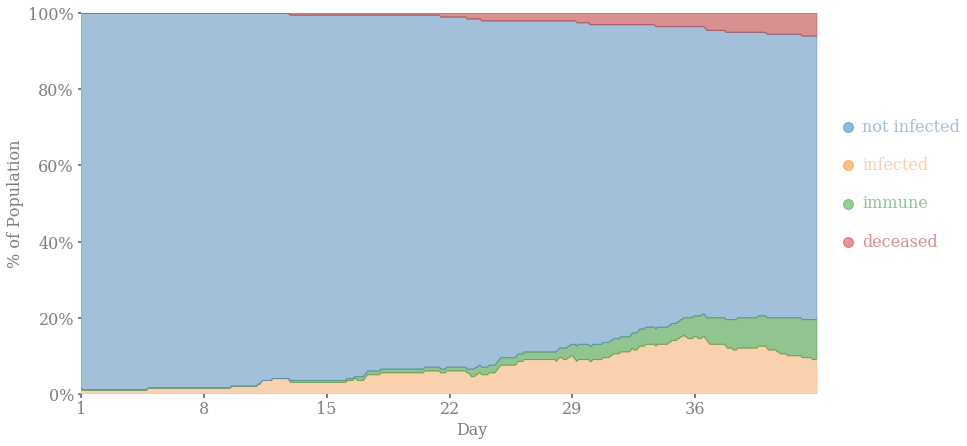

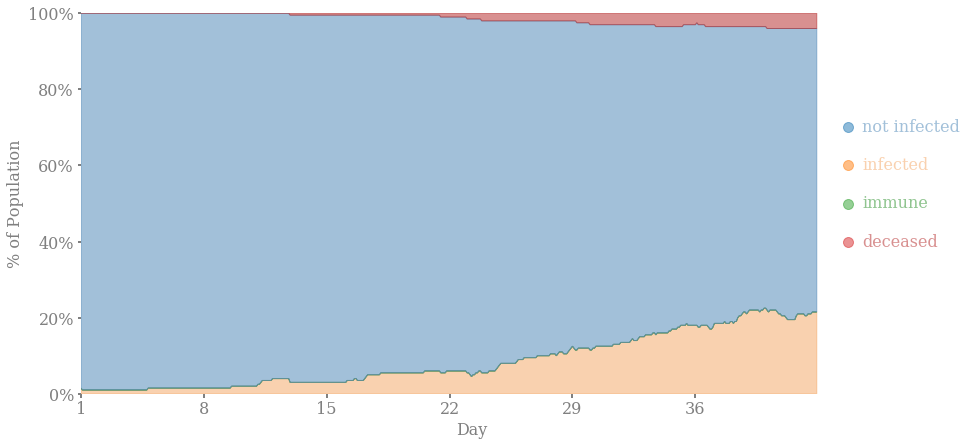

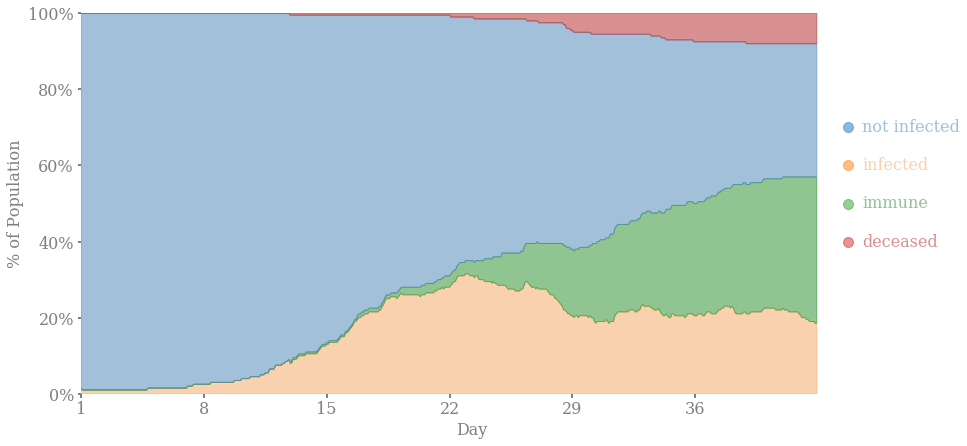

...

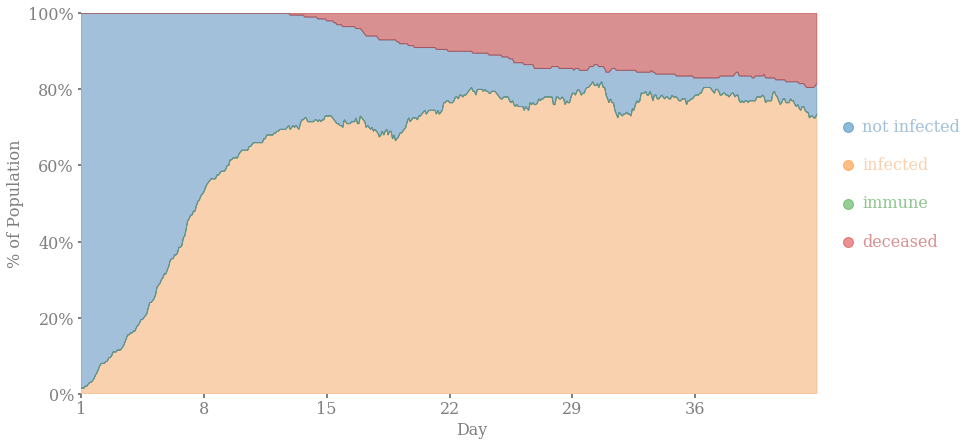

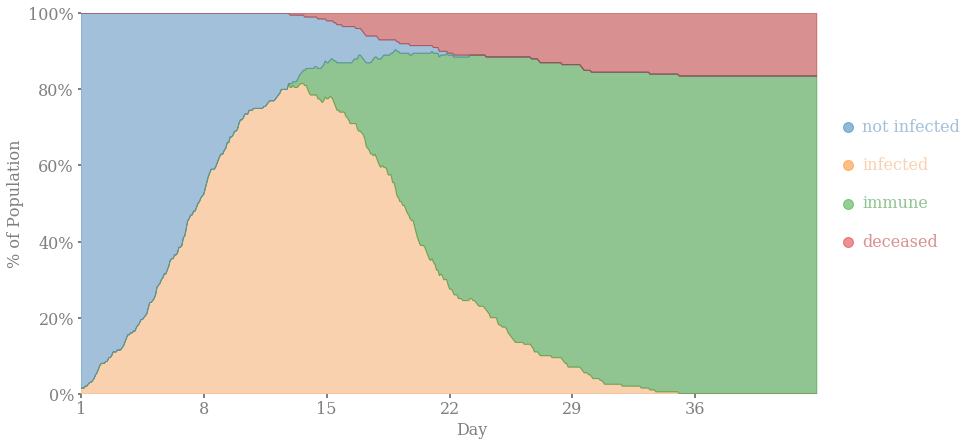

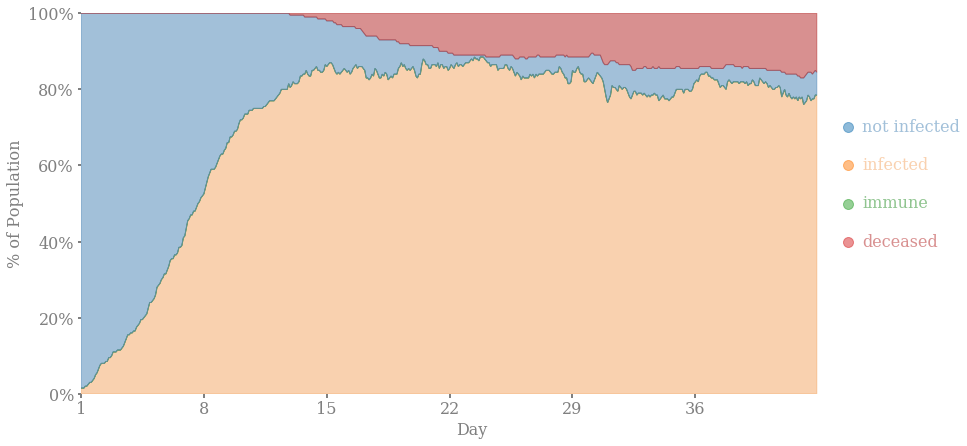

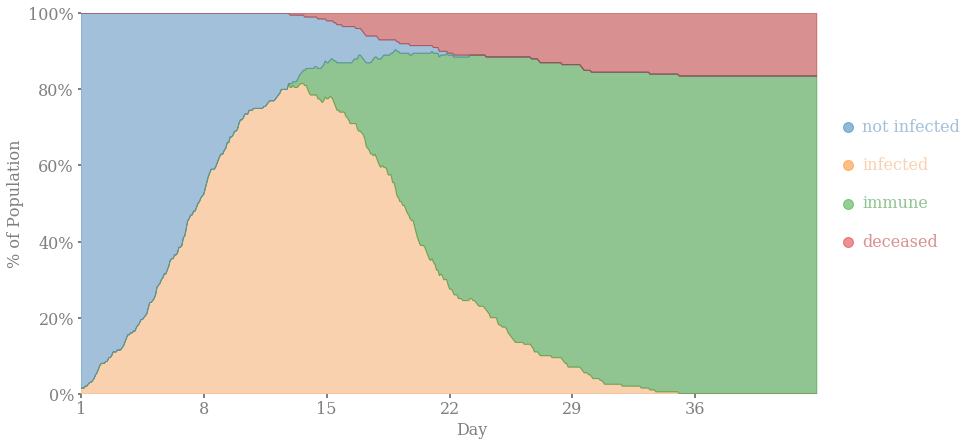

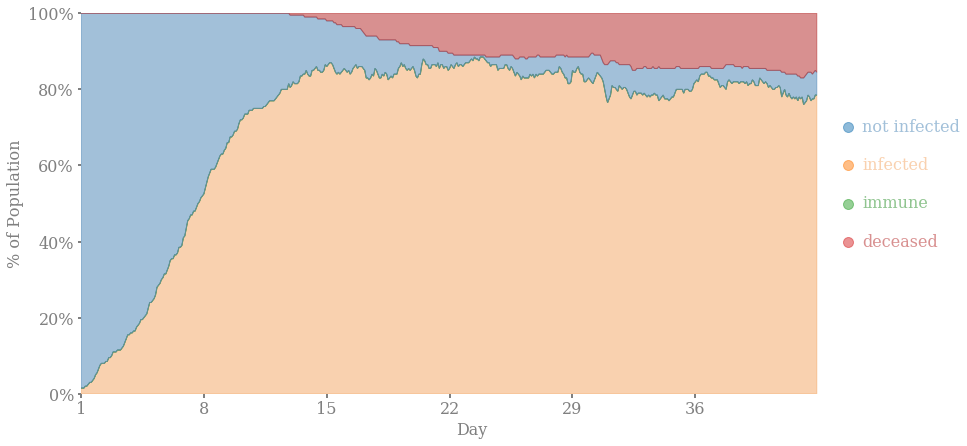

In [56]:
with tqdm.tqdm(total=len(disease_model.scenario_id_dict.keys())) as progress:
    for scenario in disease_model.scenario_id_dict.keys():
        disease_model = disease_model_class(scenario=scenario)
        disease_model.run_simulation(timesteps = 504)
        disease_model.visualise_simulation(save_as_html=True)
        disease_model.matplotlib_area_plot(save_as_png=True)
        progress.update(1)

In [9]:
disease_model = disease_model_class()
disease_model.run_multiple_scenarios(timesteps=50,
                                     scenario_list=['FFFFFF', 'TFFFFF', 'FTFFFF', 'TTFFFF'])

[autoreload of model_code failed: Traceback (most recent call last):
  File "/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 244, in check
    superreload(m, reload, self.old_objects)
  File "/anaconda3/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 378, in superreload
    module = reload(module)
  File "/anaconda3/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/anaconda3/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 600, in _exec
AttributeError: 'NoneType' object has no attribute 'name'
]
100%|██████████| 4/4 [00:03<00:00,  1.20it/s]


In [10]:
disease_model.visualise_simulation()

Saving viz for scenario FFFFFF...


In [11]:
disease_model.visualise_simulation(scenario='FFFFFF')

AttributeError: 'disease_model_class' object has no attribute 'dfplot_multi'

In [6]:
disease_model = disease_model_class()
# disease_model.run_all_scenarios(timesteps=500)
disease_model.run_simulation(timesteps=500, save_separate_output=True)

In [265]:
disease_model = disease_model_class()
disease_model.load_all_scenarios()

In [6]:
disease_model.visualise_simulation('FFFTTT')

AttributeError: 'disease_model_class' object has no attribute 'dfplot_multi'

In [5]:
disease_model.visualise_simulation('TFFFFF')

NameError: name 'disease_model' is not defined

In [215]:
id = 'FFFTFF'
id[3]

'T'

In [268]:
disease_model = disease_model_class()
disease_model.run_multiple_scenarios(timesteps=250,
                                     scenario_list=['TFFFFF', 'FTFFFF', 'TTFFFF', 'FTFFFF'])

  0%|          | 0/4 [00:10<?, ?it/s]


AttributeError: 'disease_model_class' object has no attribute 'dfplot_multi'

In [228]:
disease_model.dfplot_multi.loc[disease_model.dfplot_multi['day'] == 0, 
                               [f'infected_{i}' for i in range(64)]].sum()

infected_0     0.0
infected_1     0.0
infected_2     0.0
infected_3     0.0
infected_4     0.0
infected_5     0.0
infected_6     0.0
infected_7     0.0
infected_8     0.0
infected_9     0.0
infected_10    0.0
infected_11    0.0
infected_12    0.0
infected_13    0.0
infected_14    0.0
infected_15    0.0
infected_16    0.0
infected_17    0.0
infected_18    0.0
infected_19    0.0
infected_20    0.0
infected_21    0.0
infected_22    0.0
infected_23    0.0
infected_24    0.0
infected_25    0.0
infected_26    0.0
infected_27    0.0
infected_28    0.0
infected_29    0.0
              ... 
infected_34    0.0
infected_35    0.0
infected_36    0.0
infected_37    0.0
infected_38    0.0
infected_39    0.0
infected_40    0.0
infected_41    0.0
infected_42    0.0
infected_43    0.0
infected_44    0.0
infected_45    0.0
infected_46    0.0
infected_47    0.0
infected_48    0.0
infected_49    0.0
infected_50    0.0
infected_51    0.0
infected_52    0.0
infected_53    0.0
infected_54    0.0
infected_55 

# Plot properties

In [75]:
import os
cwd = os.getcwd()
os.chdir('../src')
from model_code import disease_model_class
os.chdir(cwd)

In [194]:
disease_model = disease_model_class(scale=0.01, 
                                    add_immunity=True)
# disease_model.load_a_scenario('FFFFFF')
disease_model.run_simulation(timesteps=12 * 30)
# fig = disease_model.visualise_simulation()

In [208]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import ffmpeg

rcParams['savefig.dpi'] = 100
rcParams['xtick.major.width'] = 2
rcParams['ytick.major.width'] = 0

rcParams['axes.spines.bottom'] = False
rcParams['axes.spines.left'] = False
rcParams['axes.spines.right'] = False
rcParams['axes.spines.top'] = False
rcParams['axes.grid'] = False
# rcParams['axes.grid.axis'] = 'y'

0
0


Traceback (most recent call last):
  File "/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/__init__.py", line 215, in process
    func(*args, **kwargs)
  File "/anaconda3/lib/python3.6/site-packages/matplotlib/animation.py", line 999, in _start
    self._init_draw()
  File "/anaconda3/lib/python3.6/site-packages/matplotlib/animation.py", line 1740, in _init_draw
    self._draw_frame(next(self.new_frame_seq()))
  File "/anaconda3/lib/python3.6/site-packages/matplotlib/animation.py", line 1765, in _draw_frame
    raise RuntimeError('The animation function must return a '
RuntimeError: The animation function must return a sequence of Artist objects.


RuntimeError: The animation function must return a sequence of Artist objects.

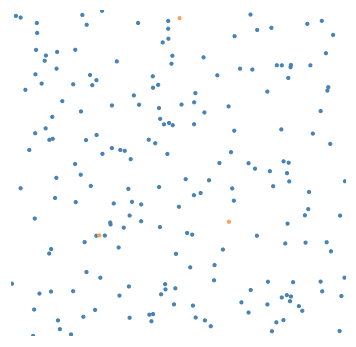

In [224]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
scat = ax.scatter(df.loc[df['day_ind'] == 0, 'x'], 
                  df.loc[df['day_ind'] == 0, 'y'], 
                  10, 
                  df.loc[df['day_ind'] == 0, 'color'])
ax.set_xticks([], [])
ax.set_yticks([], [])

def update(i, days, x, y, color):
    print(i)
    color_dict = {0: 'steelblue',
                  1: 'sandybrown',
                  2: 'forestgreen',
                  3: 'firebrick'}

    df = pd.DataFrame(columns=['day', 'x', 'y', 'color'])
    df['day'] = days
    df['x'] = x
    df['y'] = y
    df['color'] = [color_dict[col] for col in color]
    scat.set_offsets(df.loc[df['day'] == i, ['x', 'y']].values)
    scat.set_edgecolors(list(df.loc[df['day'] == i, 'color']))
    scat.set_facecolors(list(df.loc[df['day'] == i, 'color']))
    
def interpolate(i, df):
    days_list = list(df['day'].drop_duplicates()
    days_list.sort()
    
    if days_list[i] != np.round(days_list[i]):
        t = days_list[i] - np.round(days_list[i])
        x = 
        


fps = 10
df = disease_model.dfplot.copy()
df['day_frac'] = df['day_ind'] / 10

anim = FuncAnimation(fig, 
                     update, 
                     frames=df['day_ind'].max(), 
                     interval=1000 / fps, 
                     fargs=(list(df['day_ind']), 
                            list(df['x'].values),
                            list(df['y'].values),
                            list(df['infected'].astype(int))))

with open('../data/all_scenarios/test_fig.html', 'w') as myfile:
    myfile.write(anim.to_jshtml())

In [221]:
HTML(anim.to_jshtml())

In [223]:
dir(anim)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_args',
 '_blit',
 '_blit_clear',
 '_blit_draw',
 '_close_id',
 '_draw_frame',
 '_draw_next_frame',
 '_drawn_artists',
 '_end_redraw',
 '_fig',
 '_first_draw_id',
 '_func',
 '_handle_resize',
 '_html_representation',
 '_init_draw',
 '_init_func',
 '_interval',
 '_iter_gen',
 '_loop_delay',
 '_post_draw',
 '_pre_draw',
 '_repeat_delay',
 '_repr_html_',
 '_save_seq',
 '_setup_blit',
 '_start',
 '_step',
 '_stop',
 'event_source',
 'frame_seq',
 'new_frame_seq',
 'new_saved_frame_seq',
 'repeat',
 'save',
 'save_count',
 'to_html5_video',
 'to_jshtml']

In [171]:
??scat.set_offsets

In [149]:
dir(scat.set)

AttributeError: 'list' object has no attribute 'set'